### Laboratorium 4, część 1: Detekcja obiektów metodami klasycznymi

#### _Fabuła_
_Aby nauczyć głęboki model do segmentacji_ amodalnej _(tj. odpornej na okluzje między obiektami) konieczne jest skonstruowanie odpowiednio anotowanego zbioru uczącego.
Pozyskanie takich danych w drodze manualnej anotacji jest zbyt kosztowne, dlatego obiera się podejście oparte o generowanie danych syntetycznych.
Dane generowane będą na podstawie zbioru_ modalnego _, tj. zawierającego wyłącznie nieprzysłonięte obiekty.
Obiekty te należy najpierw wysegmentować ze specjalnie przygotowanych obrazów źródłowych, a następnie przeanalizować ich kształty -- ten właśnie krok będzie Twoim zadaniem._

#### Zadania

Twoim celem jest wykonanie detekcji i segmentacji _obiektów zainteresowania_ z podanych obrazów źródłowych.

W **pierwszej kolejności** przygotujesz potok przetwarzania przyjmujący obraz kolorowy w przestrzeni BGR/RGB a zwracający kolekcję obiektów opisanych (1) prostokątem otaczającym (_bounding box_) - na potrzeby detekcji, oraz (2) maską binarną **lub** konturem (tj. zbiorem koordynat punktów brzegowych).
Potok przetwarzania powinien obejmować binaryzację obrazu kolorowego (znanymi Ci już metodami), detekcję komponentów spójności ([`cv2.findContours`](https://docs.opencv.org/4.x/d3/dc0/group__imgproc__shape.html#gadf1ad6a0b82947fa1fe3c3d497f260e0)), oraz analizę blobów binarnych (obiektów).
Wykryte obiekty należy przefiltrować tak, aby pozostawić wyłącznie _obiekty zainteresowania_, tj. pojedyncze larwy.
Należy więc usunąć:
* drobne obiekty niebędące larwami,
* instancje złączone,
* wszelkie inne zakłócenia.

Zaimplementuj również funkcję pozwalającą na zaprezentowanie wyników detekcji w formie rysowania prostokątów odpowiadających instancjom oraz segmentacji w formie zaznaczania pikseli należących do instancji (może być w jednej funkcji z opcją wyboru).

**Następnie** opracujesz moduł przetwarzania poszczególnych instancji na poziomie masek binarnych lub konturów.
Moduł ten ma przyjmować pojedynczą instancję i wyznaczać dla niej podstawowe informacje, takie jak:
* długość (skorzystaj z [`skimage.morphology.skeletonize`](https://scikit-image.org/docs/stable/api/skimage.morphology.html#skimage.morphology.skeletonize)) - relatywnie łatwa do _estymacji_, ale dość trudna do precyzyjnego _pomiaru_,
* grubość - może stanowić wyzwanie,
* klasyfikację kształtu (I-kształtne, S-kształtne, C-kształtne) -- potencjalnie trudne zadanie,
* ...

Nie musisz implementować ich wszystkich: na maksymalną ocenę wystarczą dwie miary zrobione _nieźle_ lub jedna opracowana _solidnie_.

#### Oczekiwane rezultaty
1. Zaprojektowanie potoku przetwarzania do detekcji i segmentacji - skonstruuj go najlepiej jako pojedynczą funkcję, ale pozostaw ślad z dokonywanych po drodze eksperymentów, tak aby możliwe było przeanalizowanie przebiegu operacji krok po kroku.
2. Zadbaj o możliwość przetworzenia tylko wybranego RoI z obrazu, aby można było przyjrzeć się "z bliska" wybranym rejonom (np. trudniejszym) -- rekomenduję zacząć pracę od wybrania mniejszego, wygodniejszego w przetwarzaniu rejonu.
3. Działanie modułu analizy zademonstruj na kilku wybranych przykładach, także umożliwiając podgląd operacji krok po kroku.
4. Debugging - jeśli na którymkolwiek etapie pojawią się problemy, których nie potrafisz rozwiązać, postaraj się przynajmniej przeanalizować, co je powoduje.

#### Literatura
1. [`cv2.findContours`](https://docs.opencv.org/4.x/d3/dc0/group__imgproc__shape.html#gadf1ad6a0b82947fa1fe3c3d497f260e0), [OpenCV Structural Analysis and Shape Descriptors](https://docs.opencv.org/4.x/d3/dc0/group__imgproc__shape.html), [OpenCV Drawing Functions](https://docs.opencv.org/4.x/d6/d6e/group__imgproc__draw.html)
2. Publikacja, której częścią był potok przetwarzania podobny do tego, który zaimplementujesz: https://ieeexplore.ieee.org/document/10924163

In [1]:
from typing import List

import cv2
import numpy as np
import matplotlib.pyplot as plt
import skimage.morphology as skm

from dataclasses import dataclass

In [2]:
from lab4.detekcja_utils import (
    threshold_saturation,
    plot_saturation_and_mask,
    apply_morphology,
    detect_objects,
    display_object,
    show_bb,
    show_mask,
)

In [3]:
# staraj się projektować potok przetwarzania na jednym obrazie, a następnie przetestować go na drugim
calib: np.ndarray = cv2.imread("lab4/dane/proc_20221213112112426_image0.jpg")
test: np.ndarray = cv2.imread("lab4/dane/proc_20221213112219030_image0.jpg")

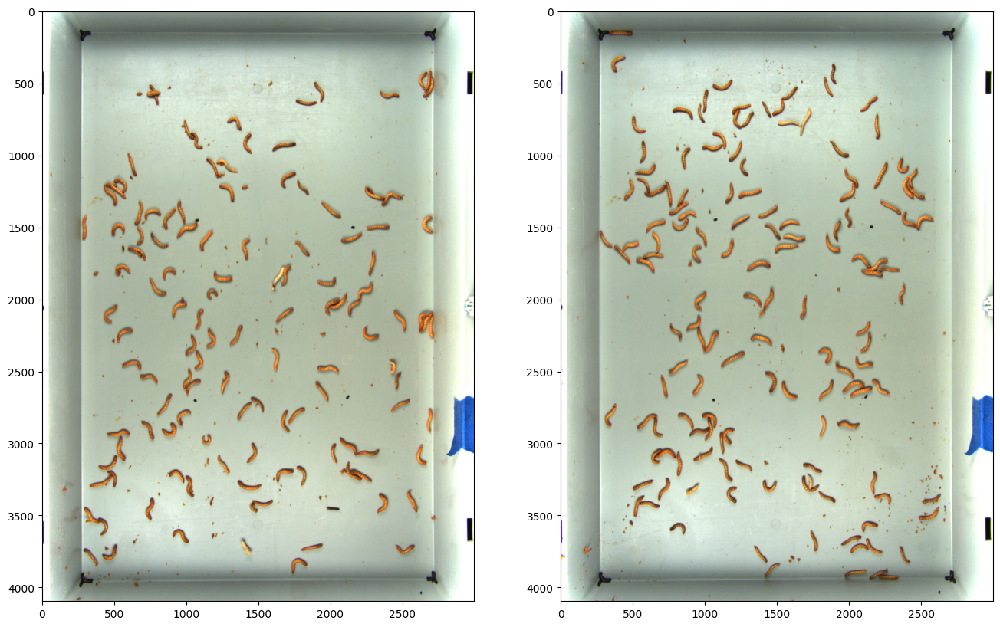

In [4]:
f, (a1, a2) = plt.subplots(1, 2, figsize=(16, 12))
a1.imshow(calib[..., ::-1].transpose((1, 0, 2)))
a2.imshow(test[..., ::-1].transpose((1, 0, 2)))

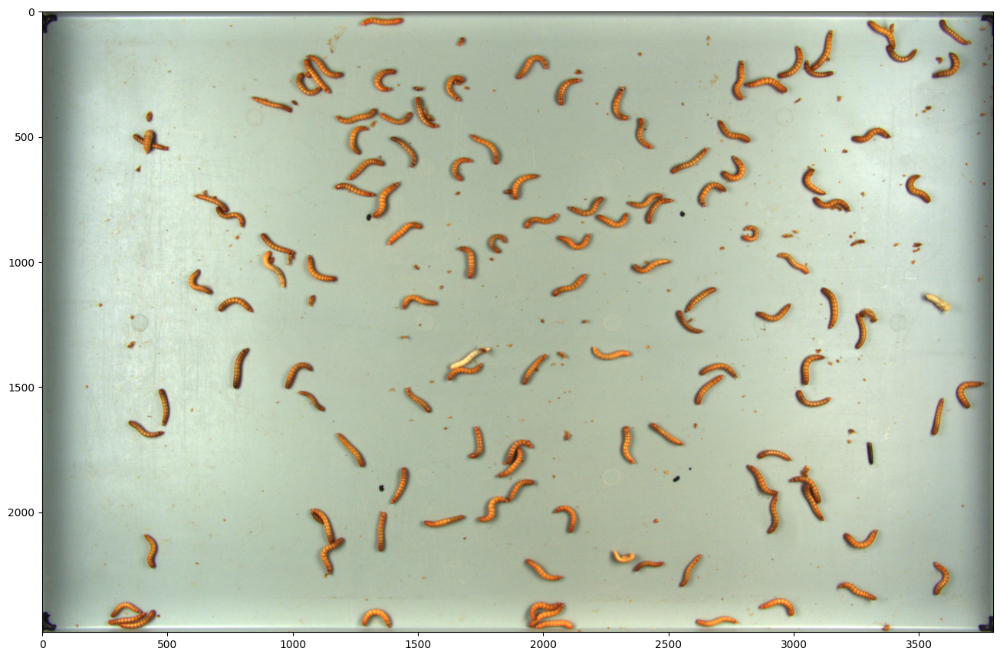

In [5]:
f, a1 = plt.subplots(1, 1, figsize=(16, 12))
calib_cropped = calib[250:-270, 150:-150]
a1.imshow(calib_cropped[..., ::-1])

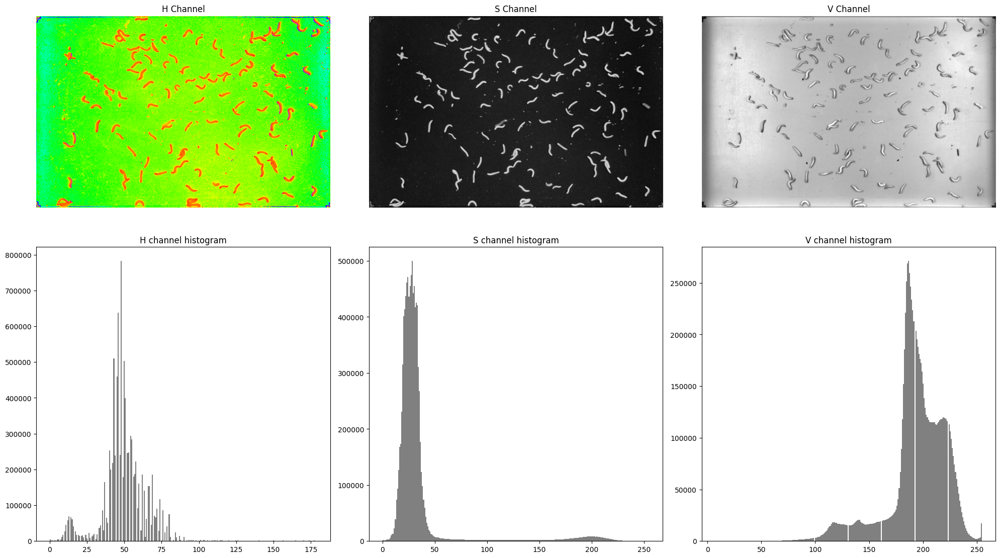

In [6]:
calib_hsv = cv2.cvtColor(calib_cropped, cv2.COLOR_BGR2HSV)

fig, axes = plt.subplots(2, 3, figsize=(20, 12))

for i, channel in enumerate(["H", "S", "V"]):
    if i == 0:
        axes[0, i].imshow(calib_hsv[:, :, i], cmap="hsv")
    else:
        axes[0, i].imshow(calib_hsv[:, :, i], cmap="gray")
    axes[0, i].set_title(f"{channel} Channel")
    axes[0, i].axis("off")

    axes[1, i].hist(calib_hsv[:, :, i].ravel(), bins=256, color="gray")
    axes[1, i].set_title(f"{channel} channel histogram")

plt.tight_layout()
plt.show()

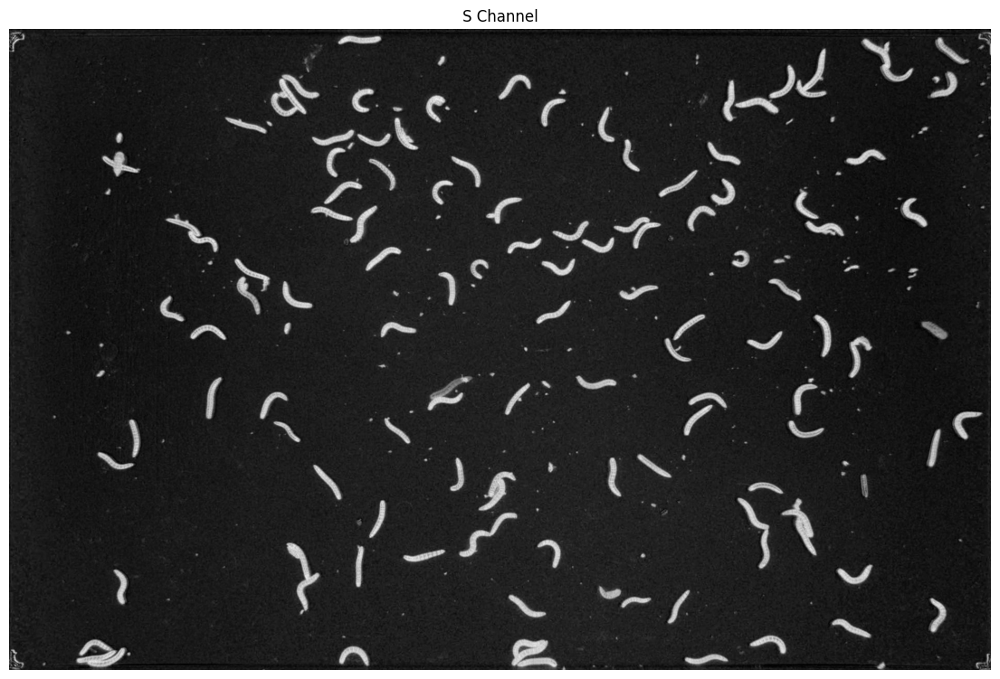

In [7]:
fig = plt.figure(figsize=(14, 10))
plt.imshow(calib_hsv[..., 1], cmap="gray")
plt.title("S Channel")
plt.axis("off")
plt.show()

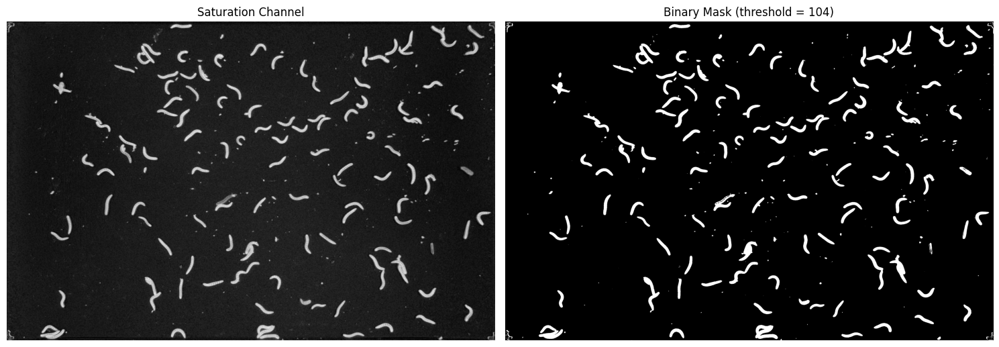

In [8]:
threshold_used, binary_image = threshold_saturation(
    calib_hsv, threshold=None, method="otsu"
)
plot_saturation_and_mask(calib_hsv, binary_image, threshold_used)

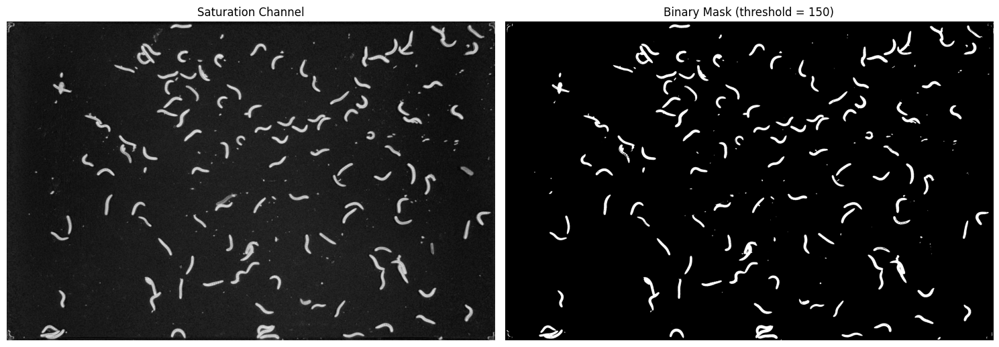

In [9]:
threshold_used, binary_image = threshold_saturation(calib_hsv, threshold=150)
plot_saturation_and_mask(calib_hsv, binary_image, threshold_used)

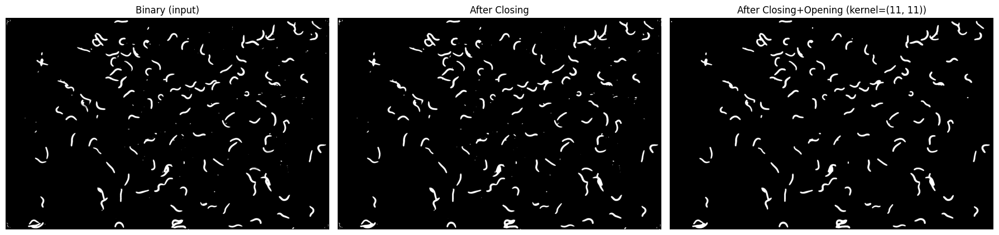

In [10]:
k, closed, opened = apply_morphology(
    binary_image, kernel_size=11, kernel_shape="rect", close_iters=1, open_iters=1
)

plt.figure(figsize=(18, 6))
plt.subplot(1, 3, 1)
plt.imshow(binary_image, cmap="gray", vmin=0, vmax=255)
plt.title("Binary (input)")
plt.axis("off")

plt.subplot(1, 3, 2)
plt.imshow(closed, cmap="gray", vmin=0, vmax=255)
plt.title("After Closing")
plt.axis("off")

plt.subplot(1, 3, 3)
plt.imshow(opened, cmap="gray", vmin=0, vmax=255)
plt.title(f"After Closing+Opening (kernel={k.shape})")
plt.axis("off")
plt.tight_layout()
plt.show()

Found 110 objects


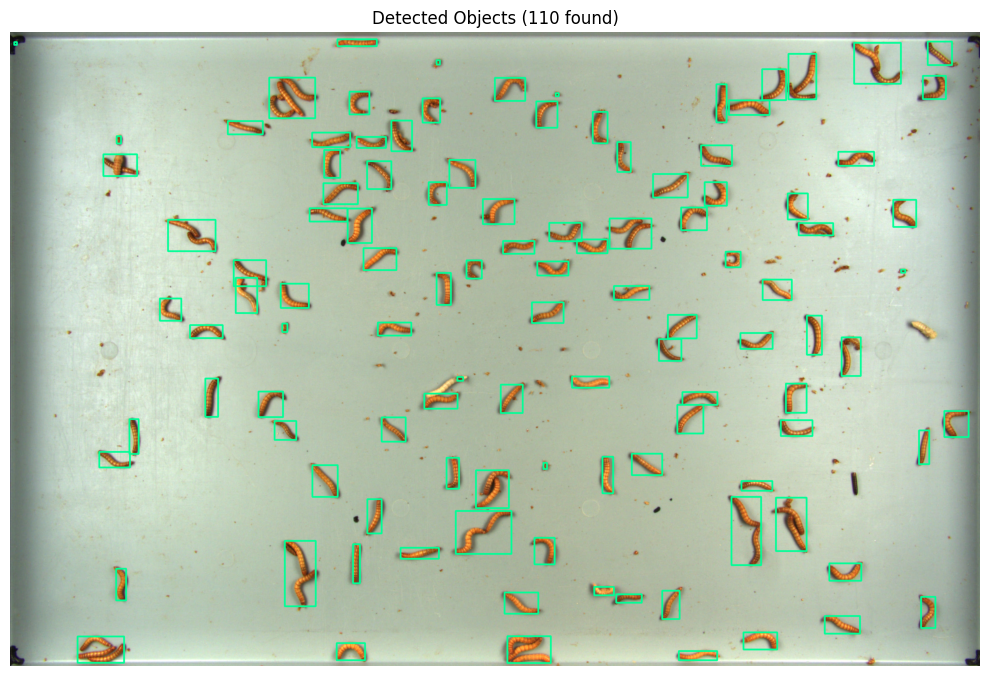

In [11]:
contours, hierarchy = cv2.findContours(
    opened, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE
)

result_img = calib_cropped.copy()

for contour in contours:
    x, y, w, h = cv2.boundingRect(contour)
    cv2.rectangle(result_img, (x, y), (x + w, y + h), (150, 255, 0), 5)

print(f"Found {len(contours)} objects")

plt.subplots(1, 1, figsize=(10, 8))
plt.imshow(result_img[..., ::-1])
plt.title(f"Detected Objects ({len(contours)} found)")
plt.axis("off")

plt.tight_layout()
plt.show()

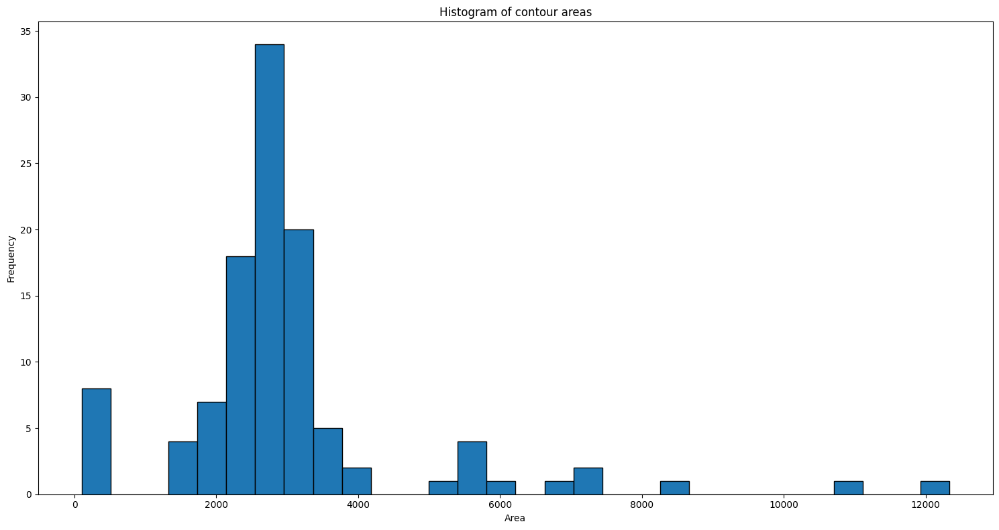

In [12]:
areas = [cv2.contourArea(contour) for contour in contours]
areas_arr = np.array(areas)

plt.figure(figsize=(15, 8))
plt.hist(areas_arr, bins=30, color="C0", edgecolor="black")
plt.xlabel("Area")
plt.ylabel("Frequency")
plt.title("Histogram of contour areas")
plt.tight_layout()
plt.show()

Found 110 objects


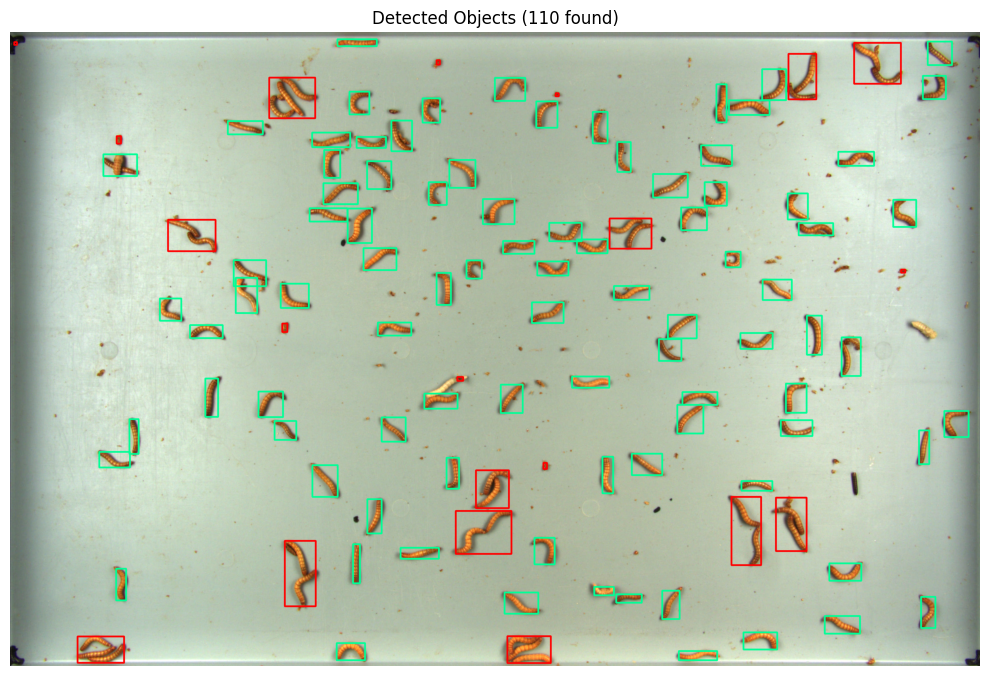

In [13]:
for contour in contours:
    x, y, w, h = cv2.boundingRect(contour)
    area = cv2.contourArea(contour)
    if area < 1000 or area > 5000:
        cv2.rectangle(result_img, (x, y), (x + w, y + h), (0, 0, 255), 5)
    else:
        cv2.rectangle(result_img, (x, y), (x + w, y + h), (150, 255, 0), 5)

print(f"Found {len(contours)} objects")

plt.subplots(1, 1, figsize=(10, 8))
plt.imshow(result_img[..., ::-1])
plt.title(f"Detected Objects ({len(contours)} found)")
plt.axis("off")

plt.tight_layout()
plt.show()

In [14]:
objects = detect_objects(calib_cropped)

Found 90 objects


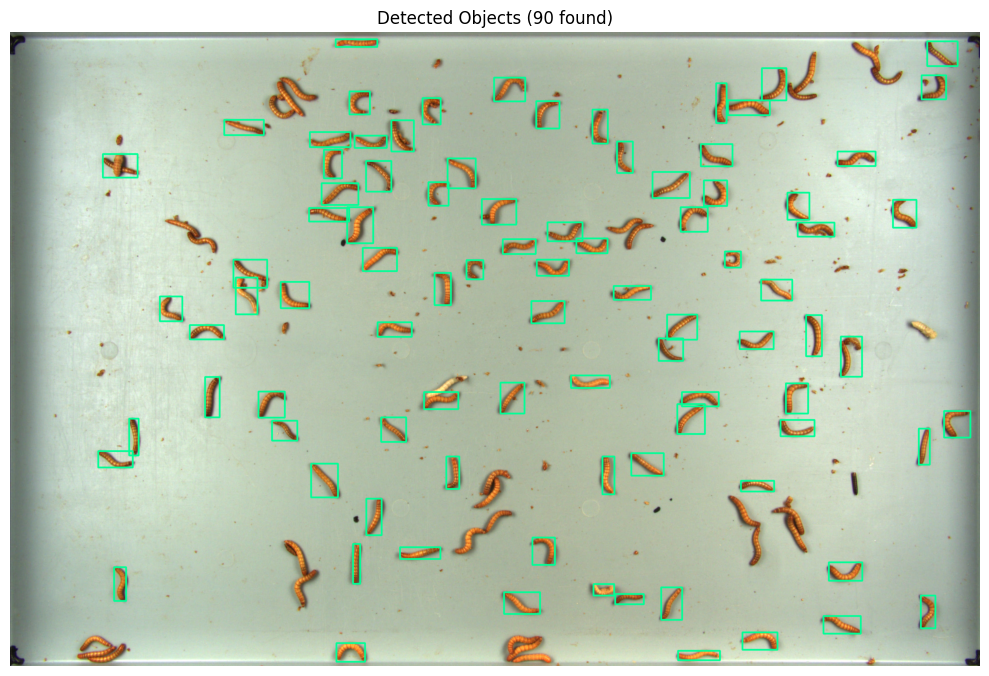

In [15]:
show_bb(calib_cropped, objects)

Found 90 objects


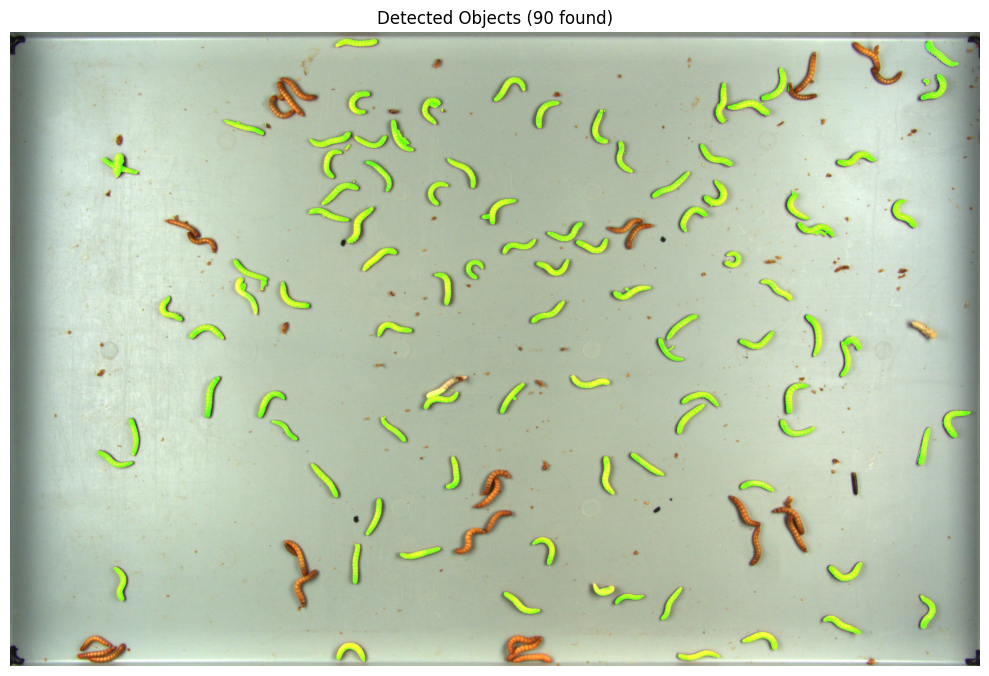

In [16]:
show_mask(calib_cropped, objects)

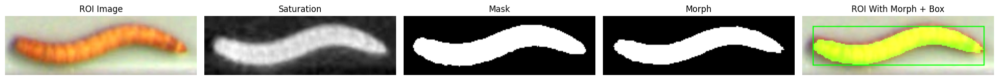

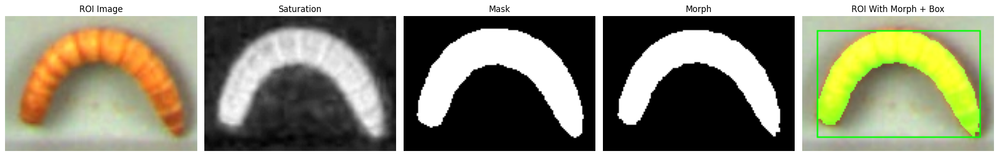

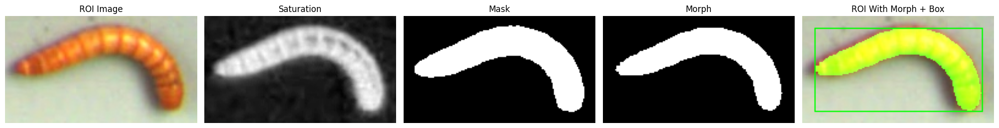

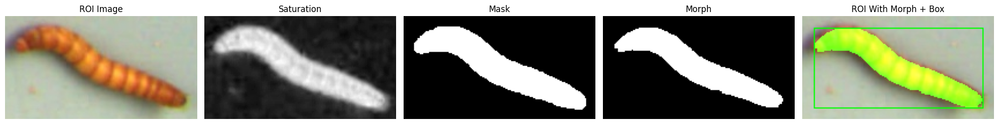

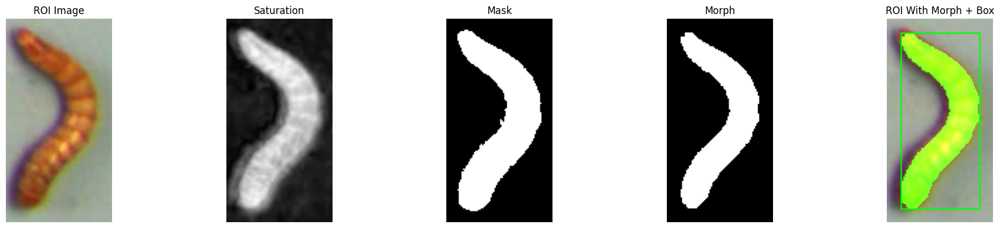

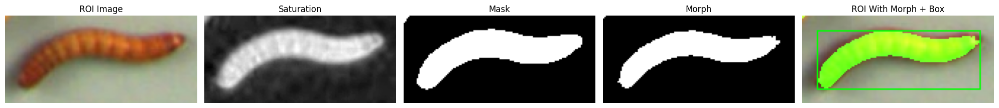

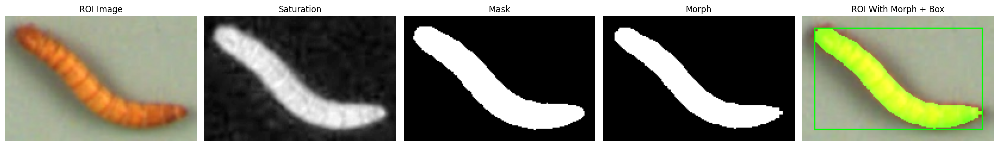

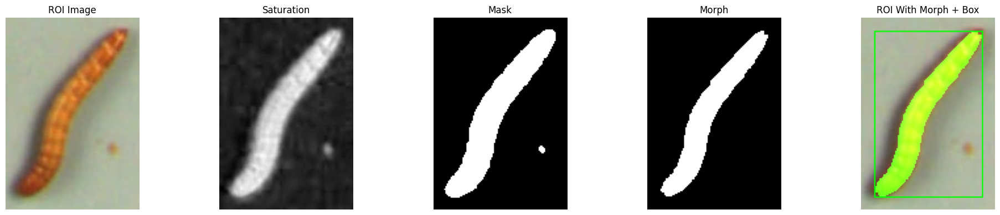

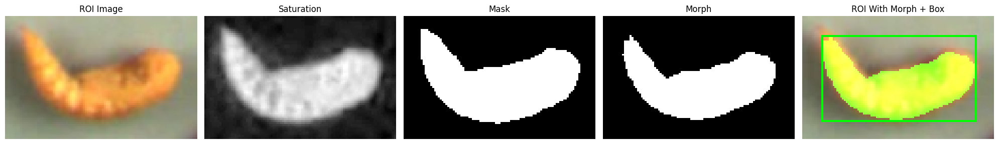

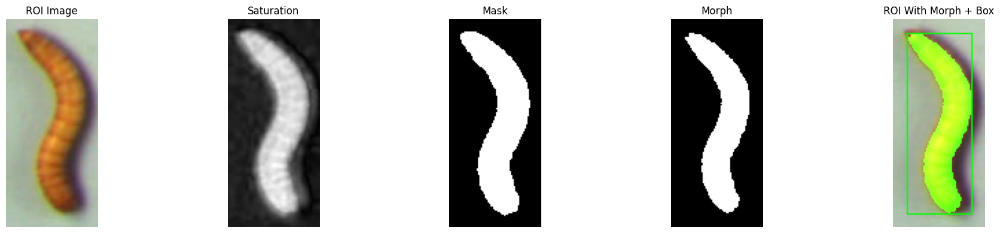

In [17]:
for object in objects[:10]:
    display_object(calib_cropped, object)

## TEST

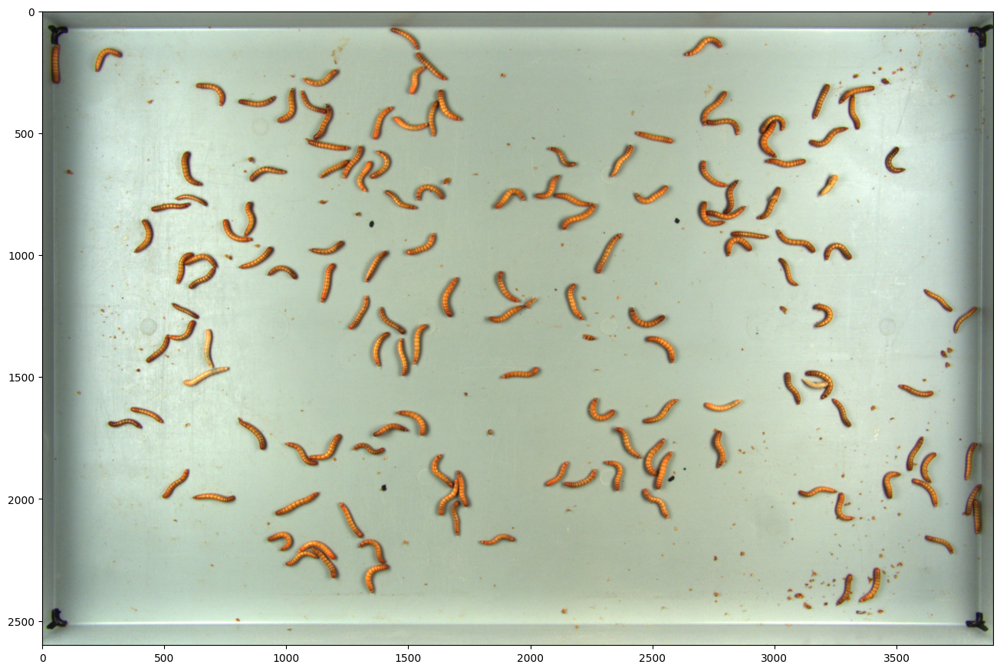

In [19]:
f, a1 = plt.subplots(1, 1, figsize=(16, 12))
test_cropped = test[200:-200, 100:-100]
a1.imshow(test_cropped[..., ::-1])

In [20]:
test_objects = detect_objects(test_cropped)

Found 93 objects


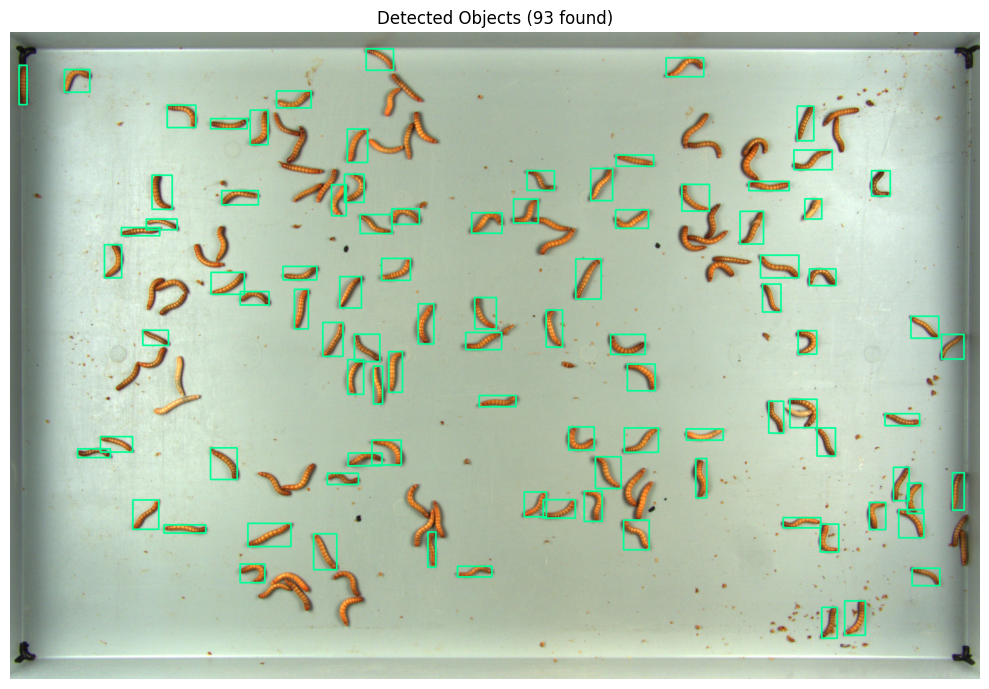

In [21]:
show_bb(test_cropped, test_objects)

Found 93 objects


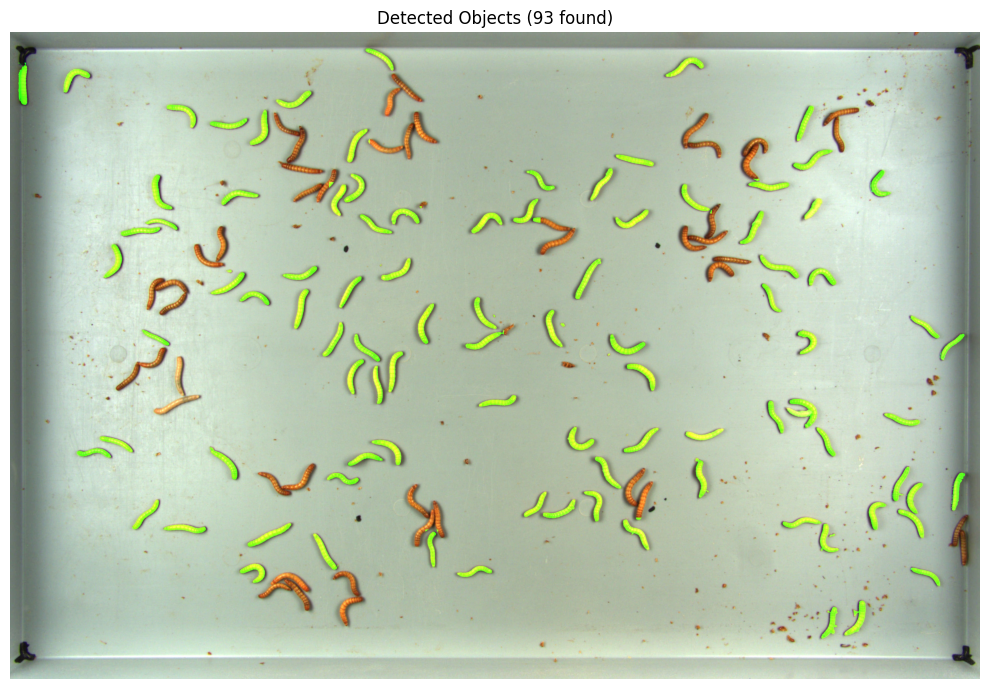

In [22]:
show_mask(test_cropped, test_objects)

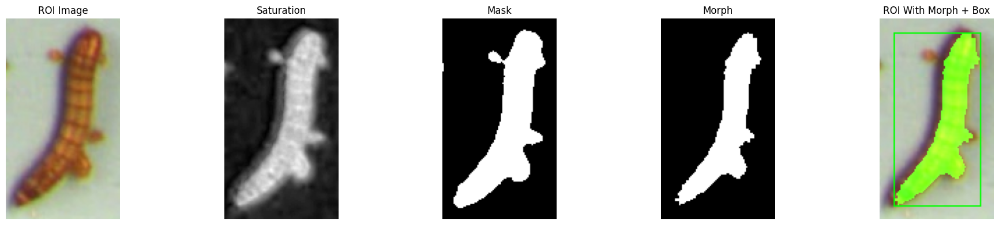

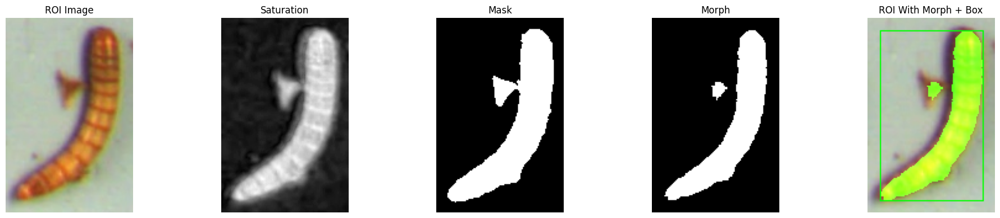

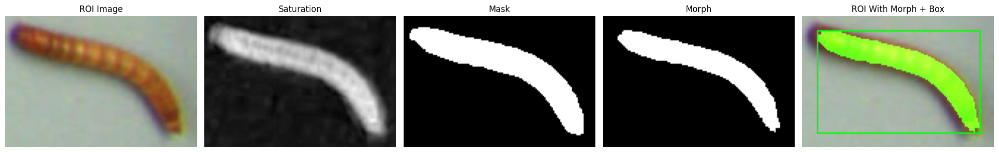

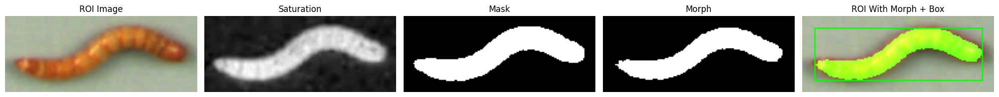

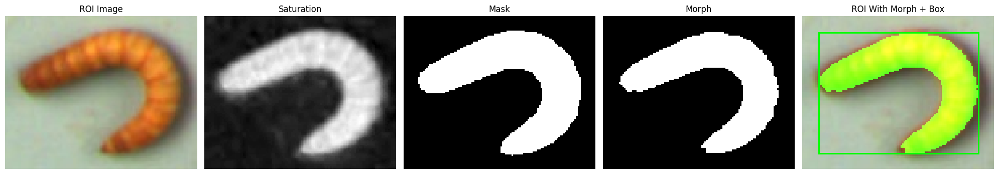

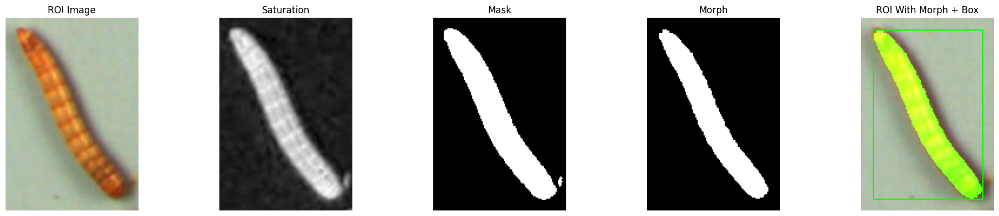

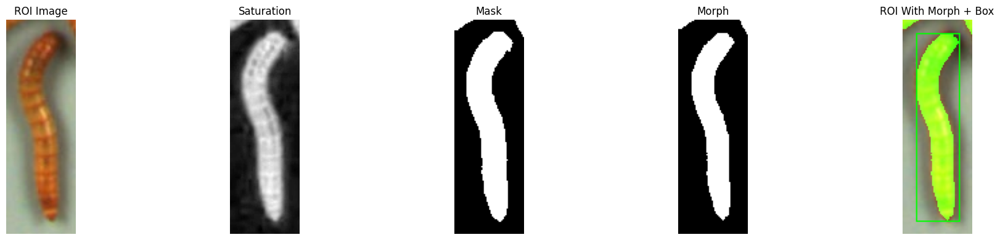

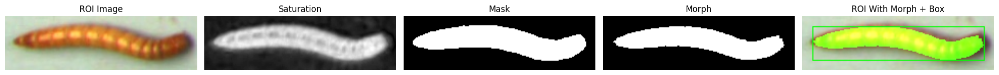

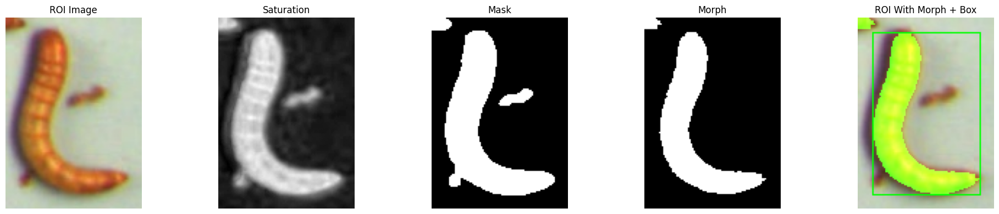

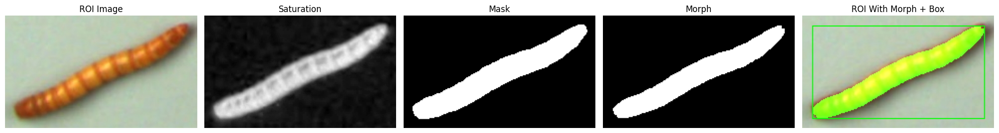

In [23]:
for object in test_objects[:10]:
    display_object(test_cropped, object)